In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('features_112x112.csv')

In [3]:
df

,f0,f1,f2,f3,f4,f5,f6,f7,f8,f9,...,f12535,f12536,f12537,f12538,f12539,f12540,f12541,f12542,f12543,label
0,0.498039,0.450980,0.478431,0.462745,0.454902,0.501961,0.431373,0.431373,0.392157,0.388235,...,0.219608,0.211765,0.149020,0.141176,0.141176,0.137255,0.137255,0.137255,0.211765,0
1,0.168627,0.164706,0.121569,0.121569,0.117647,0.117647,0.113725,0.113725,0.109804,0.109804,...,0.494118,0.356863,0.447059,0.454902,0.462745,0.466667,0.470588,0.474510,0.474510,0
2,0.211765,0.137255,0.137255,0.137255,0.141176,0.141176,0.149020,0.211765,0.219608,0.141176,...,0.392157,0.431373,0.431373,0.501961,0.454902,0.462745,0.478431,0.450980,0.498039,0
3,0.474510,0.474510,0.470588,0.466667,0.462745,0.454902,0.447059,0.356863,0.494118,0.333333,...,0.109804,0.113725,0.113725,0.117647,0.117647,0.121569,0.121569,0.164706,0.168627,0
4,0.474510,0.490196,0.458824,0.513726,0.474510,0.490196,0.458824,0.513726,0.474510,0.490196,...,0.172549,0.176471,0.133333,0.125490,0.125490,0.133333,0.125490,0.129412,0.168627,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,0.486275,0.486275,0.482353,0.478431,0.474510,0.466667,0.458824,0.360784,0.501961,0.337255,...,0.113725,0.113725,0.113725,0.117647,0.117647,0.121569,0.121569,0.168627,0.172549,1
316,0.486275,0.505882,0.470588,0.529412,0.486275,0.505882,0.470588,0.529412,0.486275,0.505882,...,0.176471,0.180392,0.125490,0.133333,0.125490,0.125490,0.125490,0.129412,0.172549,1
317,0.215686,0.211765,0.207843,0.133333,0.133333,0.129412,0.125490,0.125490,0.121569,0.117647,...,0.345098,0.470588,0.482353,0.494118,0.501961,0.509804,0.513726,0.517647,0.517647,1
318,0.172549,0.129412,0.125490,0.125490,0.125490,0.133333,0.125490,0.180392,0.176471,0.133333,...,0.486275,0.529412,0.470588,0.505882,0.486275,0.529412,0.470588,0.505882,0.486275,1


In [4]:
X = df.drop(columns=['label'])
Y = df['label']

In [5]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2, random_state=42)

In [6]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train_scaled = pd.DataFrame(sc.fit_transform(X_train), columns=X_train.columns)
X_test_scaled = pd.DataFrame(sc.fit_transform(X_test), columns=X_test.columns)

In [7]:
from sklearn.decomposition import PCA
pca = PCA(n_components=None)
X_train_trf = pca.fit_transform(X_train_scaled)
X_test_trf = pca.transform(X_test_scaled)

In [8]:
np.cumsum(pca.explained_variance_ratio_)

array([0.34362745, 0.6810646 , 0.97198913, 0.98551814, 0.99006965,
       0.99449834, 0.99694718, 0.99880786, 0.99885331, 0.9988965 ,
       0.99893556, 0.99897041, 0.99899856, 0.99902467, 0.99905031,
       0.99907275, 0.99909422, 0.99911463, 0.99913334, 0.99915174,
       0.99916895, 0.99918607, 0.99920234, 0.99921825, 0.99923382,
       0.99924899, 0.99926412, 0.99927914, 0.9992938 , 0.99930814,
       0.99932203, 0.99933577, 0.99934935, 0.99936274, 0.99937582,
       0.99938847, 0.99940091, 0.99941249, 0.99942358, 0.99943424,
       0.99944459, 0.99945487, 0.99946482, 0.99947451, 0.99948407,
       0.99949325, 0.99950218, 0.99951098, 0.99951954, 0.99952787,
       0.9995359 , 0.99954382, 0.99955173, 0.99955932, 0.99956672,
       0.99957386, 0.99958087, 0.99958772, 0.99959454, 0.99960114,
       0.99960761, 0.99961391, 0.99962013, 0.9996263 , 0.9996323 ,
       0.99963826, 0.99964411, 0.99964988, 0.9996556 , 0.99966129,
       0.99966681, 0.99967228, 0.9996777 , 0.99968303, 0.99968

In [9]:
#Moving forward with 9 components as it explains over 97% variance of the data

In [10]:
pca = PCA(n_components=3)
X_train_trf = pca.fit_transform(X_train_scaled)
X_test_trf = pca.transform(X_test_scaled)

In [11]:
X_train_trf.shape

(256, 3)

In [12]:
X_test_trf.shape

(64, 3)

In [14]:
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, classification_report

# Create the model
lgbm_clf = LGBMClassifier(
    n_estimators=500,       # number of boosting rounds
    max_depth=-1,           # no limit on tree depth
    learning_rate=0.0008,      # you can tune this
    random_state=42         # for reproducibility
)

# Train the model
lgbm_clf.fit(X_train_trf, y_train)

# Predict on train and test data
y_train_pred = lgbm_clf.predict(X_train_trf)
y_test_pred = lgbm_clf.predict(X_test_trf)

# Evaluate
print("Training Accuracy:", accuracy_score(y_train, y_train_pred))
print("Testing Accuracy:", accuracy_score(y_test, y_test_pred))
print("\nClassification Report:\n", classification_report(y_test, y_test_pred))

[LightGBM] [Info] Number of positive: 104, number of negative: 152
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 260
[LightGBM] [Info] Number of data points in the train set: 256, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.406250 -> initscore=-0.379490
[LightGBM] [Info] Start training from score -0.379490
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


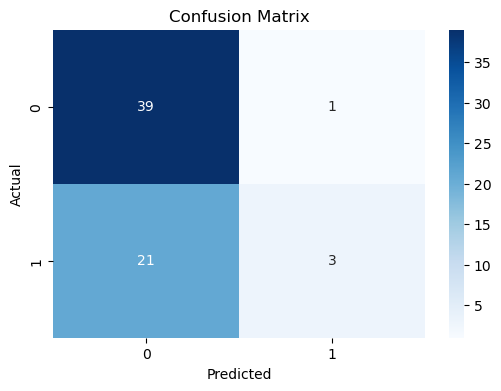

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Compute confusion matrix
cm = confusion_matrix(y_test, y_test_pred)

# Plot using seaborn
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1], yticklabels=[0, 1])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [44]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, recall_score

# Define the model
lgbm_clf = LGBMClassifier(random_state=42)

# Define hyperparameter grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 5, 7, -1],
    'num_leaves': [15, 31, 63],
    'min_child_samples': [10, 20, 30]
}

# Use recall as scoring
scorer = make_scorer(recall_score)

# Grid search
grid_search = GridSearchCV(
    estimator=lgbm_clf,
    param_grid=param_grid,
    scoring=scorer,
    cv=5,
    n_jobs=-1,
    verbose=1
)

# Fit
grid_search.fit(X_train_trf, y_train)

# Best model
best_lgbm = grid_search.best_estimator_

print("Best Parameters:", grid_search.best_params_)

Fitting 5 folds for each of 324 candidates, totalling 1620 fits
[LightGBM] [Info] Number of positive: 83, number of negative: 122
[LightGBM] [Info] Number of positive: 83, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003053 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001571 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 630
[LightGBM] [Info] Total Bins 625
[LightGBM] [Info] Number of data points in the train set: 205, number of used features: 9
[LightGBM] [Info] Number of data points in the train set: 204, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.404878 -> initscore=-0.385180
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.406863 -> initscore=-0.376950
[LightGBM]

/opt/anaconda3/lib/python3.12/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [45]:
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, classification_report

# Initialize model with best params
best_lgbm = LGBMClassifier(
    learning_rate=0.1,
    max_depth=7,
    min_child_samples=10,
    n_estimators=100,
    num_leaves=31,
    random_state=42
)

# Train the model
best_lgbm.fit(X_train_trf, y_train)

# Predict
y_train_pred = best_lgbm.predict(X_train_trf)
y_test_pred = best_lgbm.predict(X_test_trf)

# Evaluate
print("Training Accuracy:", accuracy_score(y_train, y_train_pred))
print("Testing Accuracy:", accuracy_score(y_test, y_test_pred))
print("\nClassification Report:\n", classification_report(y_test, y_test_pred))

[LightGBM] [Info] Number of positive: 104, number of negative: 152
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000170 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 777
[LightGBM] [Info] Number of data points in the train set: 256, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.406250 -> initscore=-0.379490
[LightGBM] [Info] Start training from score -0.379490
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

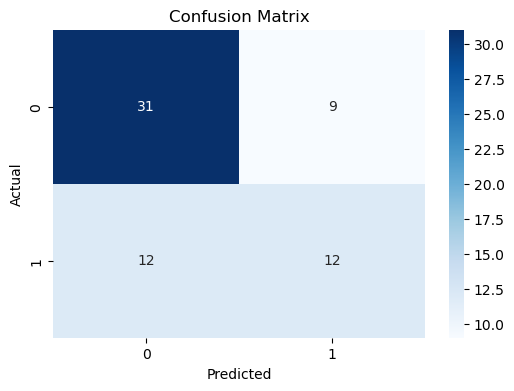

In [46]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Compute confusion matrix
cm = confusion_matrix(y_test, y_test_pred)

# Plot
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1], yticklabels=[0, 1])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
#Consider the first model as the best one from LightGBM